# Bayesian RL Models
----

Fitting Bayesian Reinforcement Learning models to action-reward data using PyMC3.

-> https://ccn.studentorg.berkeley.edu/pdfs/papers/WilsonCollins_modelFitting.pdf

[Source](https://www.pymc.io/projects/examples/en/latest/case_studies/reinforcement_learning.html)



In [2]:
import arviz as az
import matplotlib.pyplot as plt
import numpy as np
import pymc as pm
import pytensor
import pytensor.tensor as pt
import scipy

from matplotlib.lines import Line2D

WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


In [3]:
seed = sum(map(ord, "RL_PyMC"))
rng = np.random.default_rng(seed)
az.style.use("arviz-darkgrid")
%config InlineBackend.figure_format = "retina"

In [4]:
from src.rescorla_wagner_model import (RoscorlaWagner)
from src.rescorla_wagner_model_plots import (RescorlaWagnerPlots)
from src.rescorla_wagner_model_simulation import (RescorlaWagnerSimulate)
from src.rescorla_wagner_model_diagnostics import (RoscorlaWagerModelDiagnostics)

### Simulate Data

In [5]:
true_alpha = 0.3
true_beta = 5
n = 150
params = [true_alpha, true_beta]
mu = [0.4, 0.6]
# simulate 
srw = RescorlaWagnerSimulate()
actions, rewards, Q = srw.simulate(params, T=n, mu=mu, noisy_choice=True)

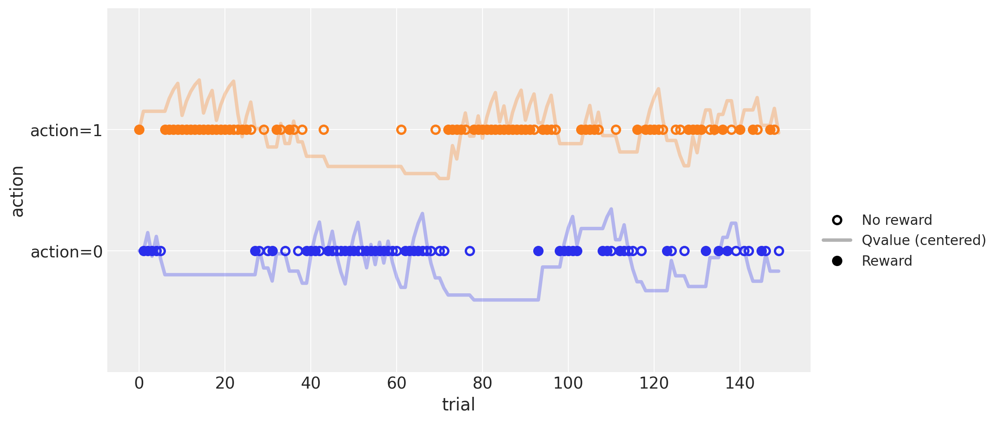

In [6]:

ax = RescorlaWagnerPlots.plot_Q_values(srw.c, srw.r, srw.Q_stored.T)
ax;

### Estimate Likelihood


In [8]:
def llik_td(x, *args):
    # Extract the arguments as they are passed by scipy.optimize.minimize
    alpha, beta = x
    actions, rewards = args

    # Initialize values
    Q = np.array([0.5, 0.5])
    logp_actions = np.zeros(len(actions))

    for t, (a, r) in enumerate(zip(actions, rewards)):
        # Apply the softmax transformation
        Q_ = Q * beta
        logp_action = Q_ - scipy.special.logsumexp(Q_)

        # Store the log probability of the observed action
        logp_actions[t] = logp_action[a]

        # Update the Q values for the next trial
        Q[a] = Q[a] + alpha * (r - Q[a])

    # Return the negative log likelihood of all observed actions
    return -np.sum(logp_actions[1:])

In [9]:
llik_td([true_alpha, true_beta], *(actions, rewards))

68.52099368355755

In [12]:
x0 = [true_alpha, true_beta]
X0 = [0.5, 2]
result = scipy.optimize.minimize(llik_td, X0, args=(actions, rewards), method="BFGS")
print(result)
print("")
print(f"MLE: alpha = {result.x[0]:.2f} (true value = {true_alpha})")
print(f"MLE: beta = {result.x[1]:.2f} (true value = {true_beta})")

  message: Optimization terminated successfully.
  success: True
   status: 0
      fun: 68.40788296476666
        x: [ 3.028e-01  5.368e+00]
      nit: 11
      jac: [ 0.000e+00 -9.537e-07]
 hess_inv: [[ 7.558e-03 -8.733e-02]
            [-8.733e-02  1.746e+00]]
     nfev: 39
     njev: 13

MLE: alpha = 0.30 (true value = 0.3)
MLE: beta = 5.37 (true value = 5)


# Repeat 100 x

In [15]:
from tqdm import tqdm

def generate_simulation_over_range(
        alpha_true_range = np.linspace(0,1,10),
        theta_true_range = np.linspace(1,10,10),
        mu=[0.2, 0.8],
        noisy_choice=True,
        log_progress=True,
    ):

    alpha_true_range = tqdm(alpha_true_range) if log_progress else alpha_true_range
    for alpha in alpha_true_range:
        for theta in theta_true_range:
            params = (alpha, theta)

            # generate data
            srw = RescorlaWagnerSimulate()
            srw.simulate(params, T=100, mu=mu, noisy_choice=noisy_choice)

            yield (params, srw)

In [22]:
generate_sim = generate_simulation_over_range()
alpha_true_range = np.linspace(0,1,10)
theta_true_range = np.linspace(1,10,10)


results = {'alpha (true)':[], 'alpha (pred)':[], 'theta (true)':[], 'theta (pred)':[]}
res_nll = np.inf
X0 = [0.5, 2]
for (params, srw) in generate_sim:
    x0 = [true_alpha, true_beta]
    actions, rewards, Q = srw.c, srw.r, srw.Q_stored.T
    result = scipy.optimize.minimize(llik_td, x0, args=(actions, rewards), method="BFGS")
    # if result.fun < res_nll:
    res_nll = result.fun
    param_fits = result.x
    
    # store results
    results['alpha (true)'].append(params[0])
    results['alpha (pred)'].append(param_fits[0])
    results['theta (true)'].append(params[1])
    results['theta (pred)'].append(param_fits[1])
    


100%|██████████| 10/10 [00:17<00:00,  1.70s/it]


In [23]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import pandas as pd
_results = pd.DataFrame(results)
print(_results.shape)
_results.head()

fig = make_subplots(rows=1, cols=2)

fig.add_trace(
    go.Scatter(x=_results['alpha (true)'], y=_results['alpha (pred)'], mode='markers', name='alpha'),
    row=1, col=1
)

# add linear line
_x = np.linspace(0,1,100)
_y = _x
fig.add_trace(go.Scatter(x=_x, y=_y, mode='lines', marker_color='black', name='y=x', showlegend=False),row=1, col=1)

fig.add_trace(
    go.Scatter(x=_results['theta (true)'], y=_results['theta (pred)'], mode='markers', name='theta'),
    row=1, col=2
)
# add linear line
_x = np.linspace(0,10,100)
_y = _x
fig.add_trace(go.Scatter(x=_x, y=_y, mode='lines', marker_color='black', name='y=x', showlegend=False),row=1, col=2)

fig.update_layout(height=600, width=800, title_text="Sensitivity Analysis: Parameter Stability Estimate", template='none')
fig.show()

(100, 4)


In [24]:
def llik_td_vectorized(x, *args):
    # Extract the arguments as they are passed by scipy.optimize.minimize
    alpha, beta = x
    actions, rewards = args

    # Create a list with the Q values of each trial
    Qs = np.ones((n, 2), dtype="float64")
    Qs[0] = 0.5
    for t, (a, r) in enumerate(
        zip(actions[:-1], rewards[:-1])
    ):  # The last Q values were never used, so there is no need to compute them
        Qs[t + 1, a] = Qs[t, a] + alpha * (r - Qs[t, a])
        Qs[t + 1, 1 - a] = Qs[t, 1 - a]

    # Apply the softmax transformation in a vectorized way
    Qs_ = Qs * beta
    logp_actions = Qs_ - scipy.special.logsumexp(Qs_, axis=1)[:, None]

    # Return the logp_actions for the observed actions
    logp_actions = logp_actions[np.arange(len(actions)), actions]
    return -np.sum(logp_actions[1:])

In [25]:
llik_td_vectorized([true_alpha, true_beta], *(actions, rewards))

22.442732351715378

In [26]:
def update_Q(action, reward, Qs, alpha):
    """
    This function updates the Q table according to the RL update rule.
    It will be called by pytensor.scan to do so recursevely, given the observed data and the alpha parameter
    This could have been replaced be the following lamba expression in the pytensor.scan fn argument:
        fn=lamba action, reward, Qs, alpha: pt.set_subtensor(Qs[action], Qs[action] + alpha * (reward - Qs[action]))
    """

    Qs = pt.set_subtensor(Qs[action], Qs[action] + alpha * (reward - Qs[action]))
    return Qs

In [27]:
# Transform the variables into appropriate PyTensor objects
rewards_ = pt.as_tensor_variable(rewards, dtype="int32")
actions_ = pt.as_tensor_variable(actions, dtype="int32")

alpha = pt.scalar("alpha")
beta = pt.scalar("beta")

# Initialize the Q table
Qs = 0.5 * pt.ones((2,), dtype="float64")

# Compute the Q values for each trial
Qs, _ = pytensor.scan(
    fn=update_Q, sequences=[actions_, rewards_], outputs_info=[Qs], non_sequences=[alpha]
)

# Apply the softmax transformation
Qs = Qs * beta
logp_actions = Qs - pt.logsumexp(Qs, axis=1, keepdims=True)

# Calculate the negative log likelihod of the observed actions
logp_actions = logp_actions[pt.arange(actions_.shape[0] - 1), actions_[1:]]
neg_loglike = -pt.sum(logp_actions)

In [28]:
pytensor_llik_td = pytensor.function(
    inputs=[alpha, beta], outputs=neg_loglike, on_unused_input="ignore"
)
result = pytensor_llik_td(true_alpha, true_beta)
float(result)

22.442732351715375

In [29]:
def pytensor_llik_td(alpha, beta, actions, rewards):
    rewards = pt.as_tensor_variable(rewards, dtype="int32")
    actions = pt.as_tensor_variable(actions, dtype="int32")

    # Compute the Qs values
    Qs = 0.5 * pt.ones((2,), dtype="float64")
    Qs, updates = pytensor.scan(
        fn=update_Q, sequences=[actions, rewards], outputs_info=[Qs], non_sequences=[alpha]
    )

    # Apply the sotfmax transformation
    Qs = Qs[:-1] * beta
    logp_actions = Qs - pt.logsumexp(Qs, axis=1, keepdims=True)

    # Calculate the log likelihood of the observed actions
    logp_actions = logp_actions[pt.arange(actions.shape[0] - 1), actions[1:]]
    return pt.sum(logp_actions)  # PyMC expects the standard log-likelihood

### Simulate Actions + Reward

In [37]:
true_alpha = 0.3
true_beta = 5
n = 150
params = [true_alpha, true_beta]
mu = [0.4, 0.6]
# simulate 
srw = RescorlaWagnerSimulate()
actions, rewards, Q = srw.simulate(params, T=n, mu=mu, noisy_choice=True)

### Run Model

In [38]:
with pm.Model() as m:
    alpha = pm.Beta(name="alpha", alpha=1, beta=1)
    beta = pm.HalfNormal(name="beta", sigma=10)

    like = pm.Potential(name="like", var=pytensor_llik_td(alpha, beta, actions, rewards))

    tr = pm.sample(random_seed=rng)

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [alpha, beta]


Output()

Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 12 seconds.


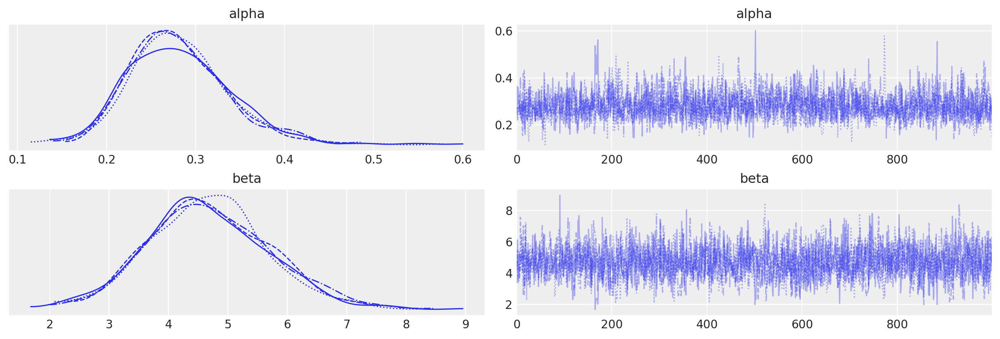

In [39]:
az.plot_trace(data=tr);


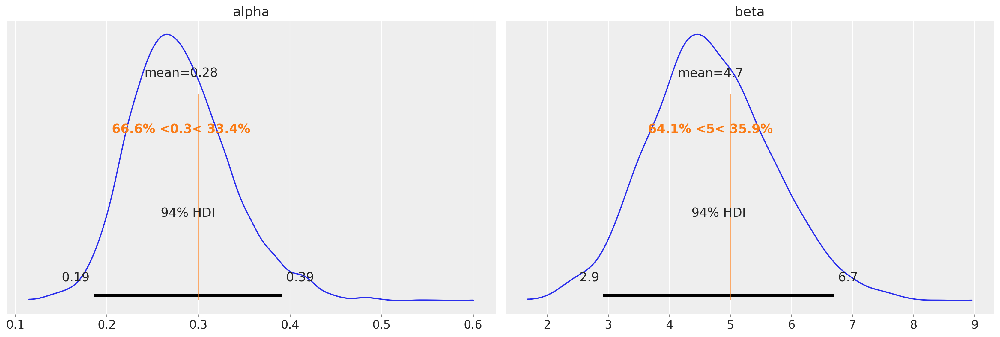

In [40]:
az.plot_posterior(data=tr, ref_val=[true_alpha, true_beta]);

# Bernoulie Liklihood

In [41]:
def right_action_probs(alpha, beta, actions, rewards):
    rewards = pt.as_tensor_variable(rewards, dtype="int32")
    actions = pt.as_tensor_variable(actions, dtype="int32")

    # Compute the Qs values
    Qs = 0.5 * pt.ones((2,), dtype="float64")
    Qs, updates = pytensor.scan(
        fn=update_Q, sequences=[actions, rewards], outputs_info=[Qs], non_sequences=[alpha]
    )

    # Apply the sotfmax transformation
    Qs = Qs[:-1] * beta
    logp_actions = Qs - pt.logsumexp(Qs, axis=1, keepdims=True)

    # Return the probabilities for the right action, in the original scale
    return pt.exp(logp_actions[:, 1])

In [42]:
with pm.Model() as m_alt:
    alpha = pm.Beta(name="alpha", alpha=1, beta=1)
    beta = pm.HalfNormal(name="beta", sigma=10)

    action_probs = right_action_probs(alpha, beta, actions, rewards)
    like = pm.Bernoulli(name="like", p=action_probs, observed=actions[1:])

    tr_alt = pm.sample(random_seed=rng)

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [alpha, beta]


Output()

Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 12 seconds.


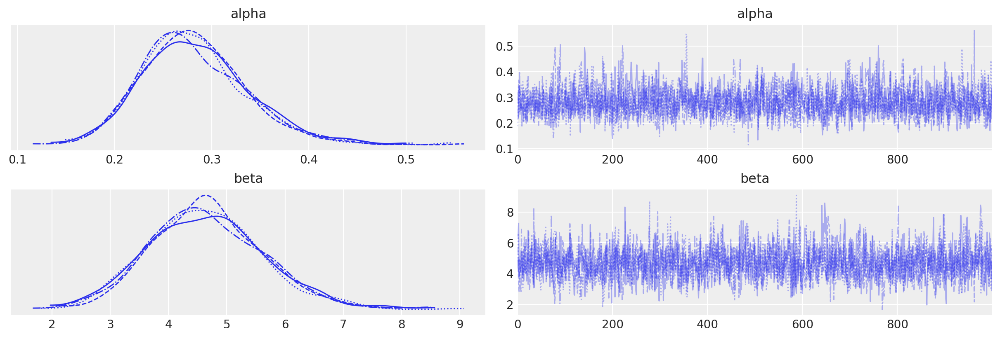

In [43]:
az.plot_trace(data=tr_alt);

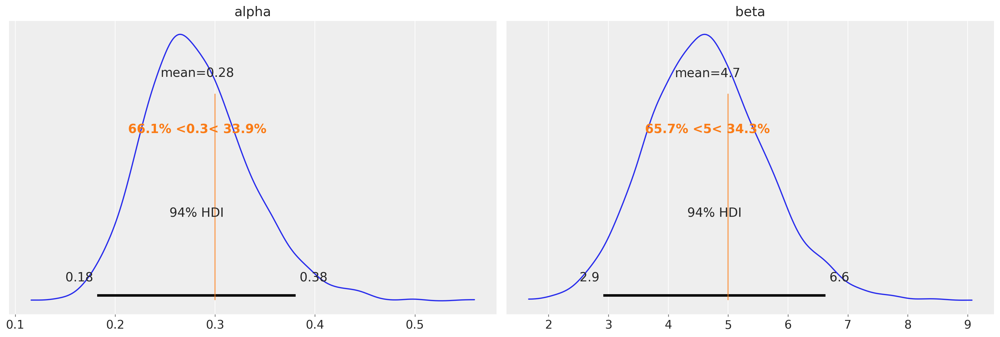

In [44]:
az.plot_posterior(data=tr_alt, ref_val=[true_alpha, true_beta]);

# Using Behaviour Pilot Data

In [51]:

from process_data.extract_matlab_data import load_processed_data
from src.helpers import log_rat_metadata, log_sequence_data, load_config
from src.query_dataset import (QuerySequenceData, load_data)

In [52]:
# load yaml config
_config = load_config('config.yaml')

(data,
 sequence_data,
 meta_data,
 StimCode,
 RespCode
 ) = load_data(config=_config, experiment_class='human_pilot_experiment')

In [54]:
data
meta_data

,participantID,SessionType,SessionNum,CondNum,ReleMode
0,1,training,1,1,1
1,1,training,2,1,1
2,1,ids1,1,2,1
3,1,staircase1,1,3,1
4,1,staircase1,2,3,1
...,...,...,...,...,...
279,22,staircase2,1,7,0
280,22,staircase2,2,7,0
281,22,ams2,1,8,0
282,22,ams2,2,8,0


In [56]:

# example usage
qsd = QuerySequenceData(StimCode, RespCode)


In [57]:
session_Types = np.unique([k[1] for k in StimCode.keys()])
session_Types

session_Groups = [
    ['ams1', 'ams2'],
    ['eds1', 'eds2'],
    ['ids1', 'ids2'],
    ['staircase1', 'staircase2'],
    ['training']
    ]

subject_IDs = np.unique([k[0] for k in StimCode.keys()])

# groupings: (subject_ID, <session_Groups>, <all>)
experiments = []
for _subject in subject_IDs:
    for session_Group in session_Groups:
        new_experiment = []
        for _session_Type in session_Group:
            new_experiment.append((_subject, _session_Type, None))
        experiments.append(new_experiment)


experiments[:2]

[[(1, 'ams1', None), (1, 'ams2', None)],
 [(1, 'eds1', None), (1, 'eds2', None)]]

In [60]:
experiment = experiments[0]

# extract data
for _key in experiments[0]:
    qsd.filter_sequences(*_key, update_existing_stim_resp=True)
qsd.extract_stim_resp_data()
qsd.infer_action_reward_pairs()
ACTIONS = qsd._action
REWARDS = qsd._reward


In [64]:
def fit_Bernoulli(actions, rewards):
    with pm.Model() as m_alt:
        alpha = pm.Beta(name="alpha", alpha=1, beta=1)
        beta = pm.HalfNormal(name="beta", sigma=10)

        action_probs = right_action_probs(alpha, beta, actions, rewards)
        like = pm.Bernoulli(name="like", p=action_probs, observed=actions[1:])

        tr_alt = pm.sample(random_seed=rng)

    return m_alt, like, tr_alt

In [65]:
fit_Bernoulli(ACTIONS, REWARDS)

Auto-assigning NUTS sampler...
INFO:pymc.sampling.mcmc:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc.sampling.mcmc:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
INFO:pymc.sampling.mcmc:Multiprocess sampling (4 chains in 4 jobs)
NUTS: [alpha, beta]
INFO:pymc.sampling.mcmc:NUTS: [alpha, beta]


Output()

Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 22 seconds.
INFO:pymc.sampling.mcmc:Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 22 seconds.
There were 19 divergences after tuning. Increase `target_accept` or reparameterize.
ERROR:pymc.stats.convergence:There were 19 divergences after tuning. Increase `target_accept` or reparameterize.


(alpha ~ Beta(1, 1)
  beta ~ HalfNormal(0, 10)
  like ~ Bernoulli(f(beta, alpha)),
 like ~ Bernoulli(f(beta, alpha)),
 Inference data with groups:
 	> posterior
 	> sample_stats
 	> observed_data)

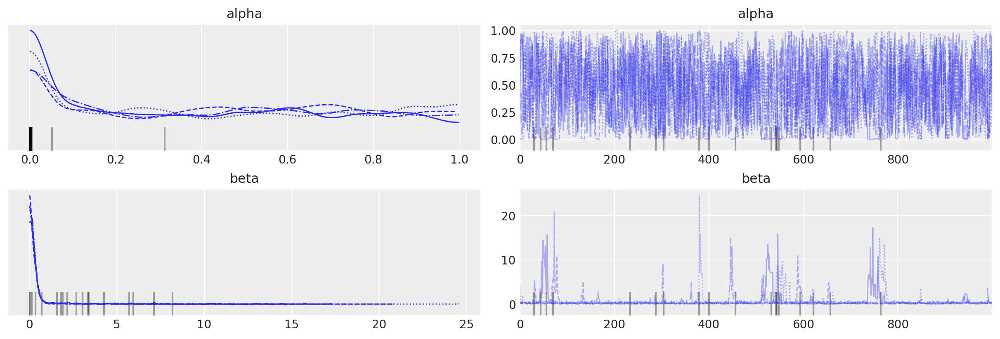

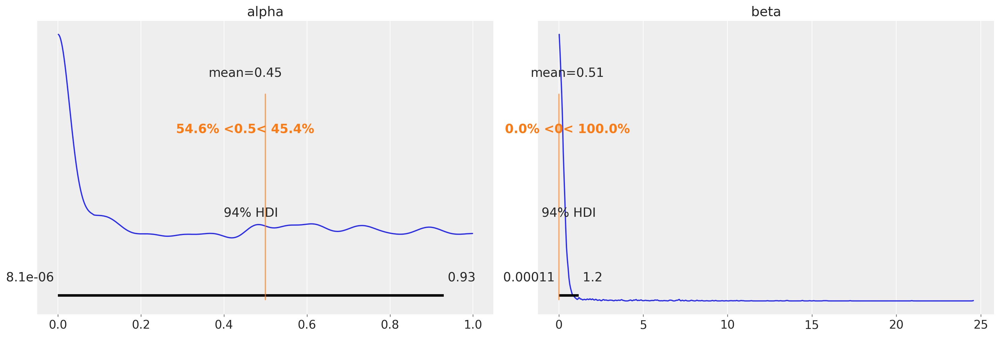

In [63]:
az.plot_trace(data=tr_alt);
az.plot_posterior(data=tr_alt, ref_val=[0.5, 0]);

..........................................................................................
Experiment: [(1, 'ams1', None), (1, 'ams2', None)]


Auto-assigning NUTS sampler...
INFO:pymc.sampling.mcmc:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc.sampling.mcmc:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
INFO:pymc.sampling.mcmc:Multiprocess sampling (4 chains in 4 jobs)
NUTS: [alpha, beta]
INFO:pymc.sampling.mcmc:NUTS: [alpha, beta]


Output()

Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 22 seconds.
INFO:pymc.sampling.mcmc:Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 22 seconds.
There were 22 divergences after tuning. Increase `target_accept` or reparameterize.
ERROR:pymc.stats.convergence:There were 22 divergences after tuning. Increase `target_accept` or reparameterize.


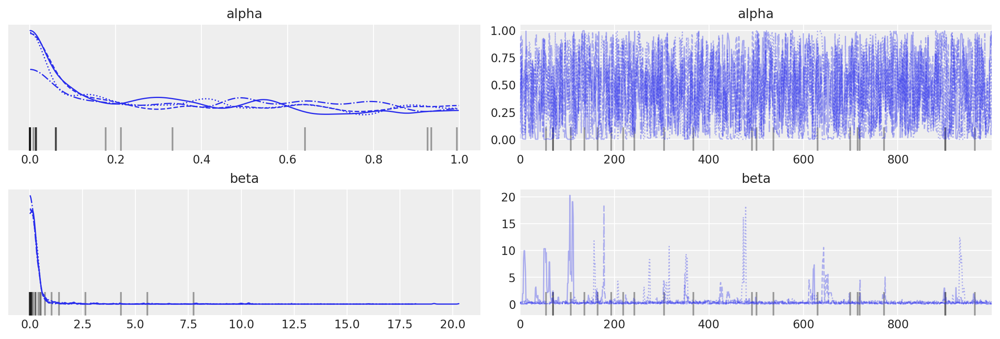

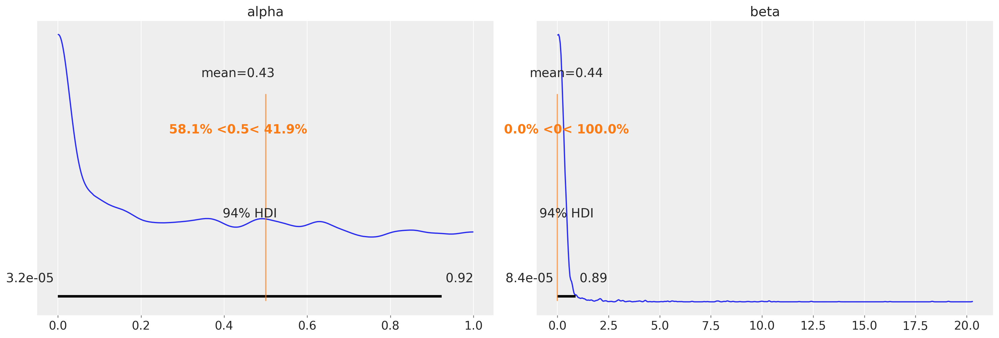

..........................................................................................
Experiment: [(1, 'eds1', None), (1, 'eds2', None)]


Auto-assigning NUTS sampler...
INFO:pymc.sampling.mcmc:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc.sampling.mcmc:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
INFO:pymc.sampling.mcmc:Multiprocess sampling (4 chains in 4 jobs)
NUTS: [alpha, beta]
INFO:pymc.sampling.mcmc:NUTS: [alpha, beta]


Output()

Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 13 seconds.
INFO:pymc.sampling.mcmc:Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 13 seconds.
There were 2 divergences after tuning. Increase `target_accept` or reparameterize.
ERROR:pymc.stats.convergence:There were 2 divergences after tuning. Increase `target_accept` or reparameterize.


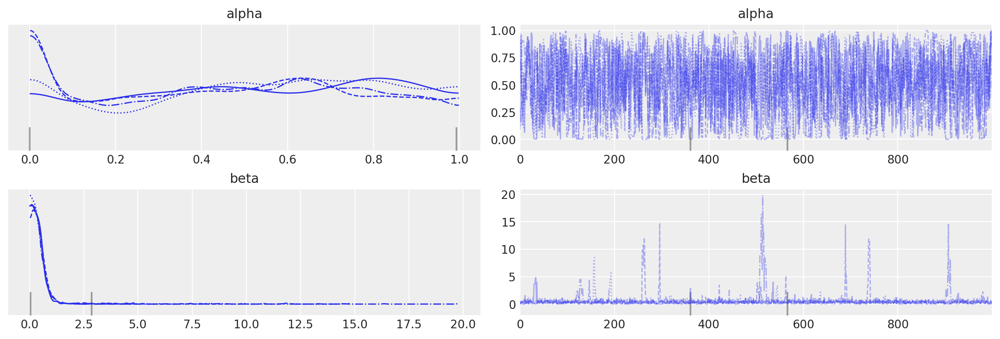

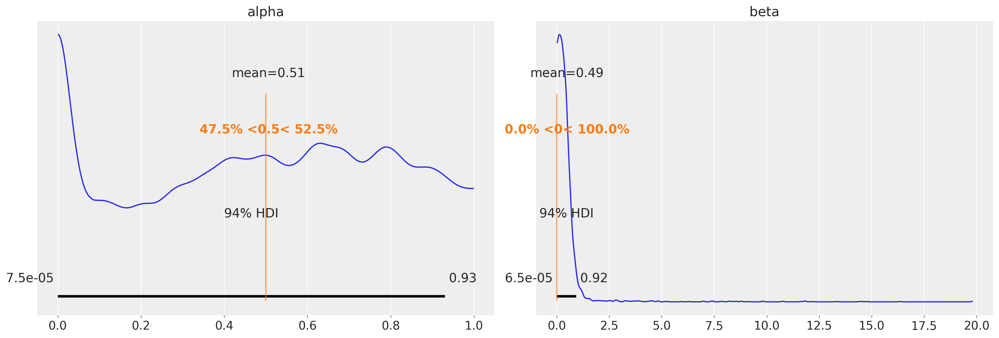

..........................................................................................
Experiment: [(1, 'ids1', None), (1, 'ids2', None)]


Auto-assigning NUTS sampler...
INFO:pymc.sampling.mcmc:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc.sampling.mcmc:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
INFO:pymc.sampling.mcmc:Multiprocess sampling (4 chains in 4 jobs)
NUTS: [alpha, beta]
INFO:pymc.sampling.mcmc:NUTS: [alpha, beta]


Output()

Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 18 seconds.
INFO:pymc.sampling.mcmc:Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 18 seconds.
There were 7 divergences after tuning. Increase `target_accept` or reparameterize.
ERROR:pymc.stats.convergence:There were 7 divergences after tuning. Increase `target_accept` or reparameterize.


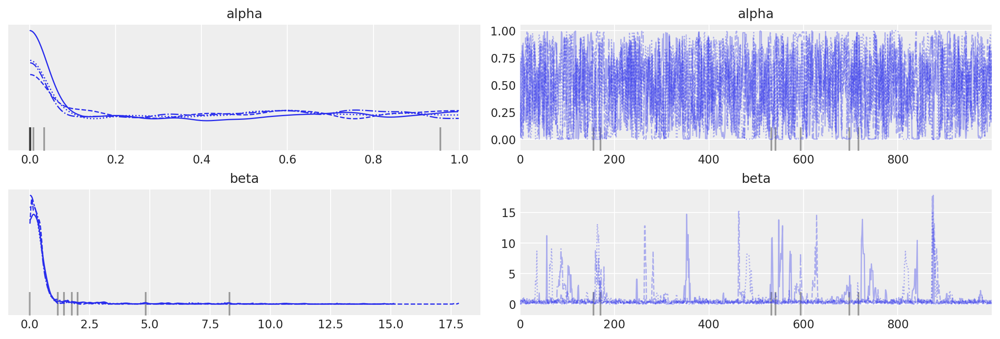

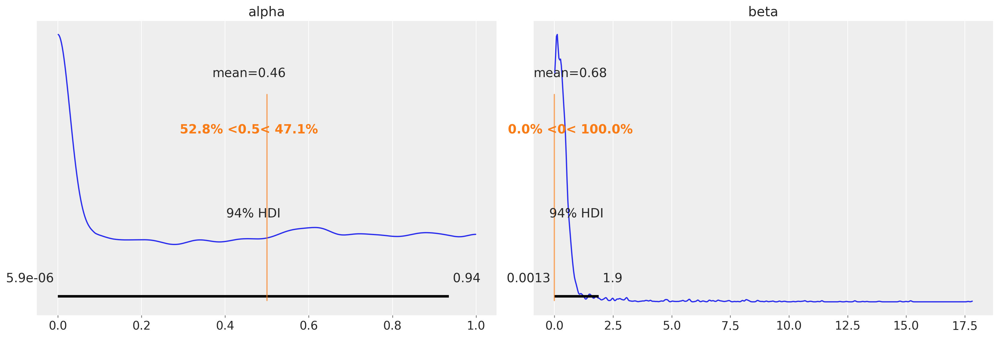

..........................................................................................
Experiment: [(1, 'staircase1', None), (1, 'staircase2', None)]


Auto-assigning NUTS sampler...
INFO:pymc.sampling.mcmc:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc.sampling.mcmc:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
INFO:pymc.sampling.mcmc:Multiprocess sampling (4 chains in 4 jobs)
NUTS: [alpha, beta]
INFO:pymc.sampling.mcmc:NUTS: [alpha, beta]


Output()

Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 19 seconds.
INFO:pymc.sampling.mcmc:Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 19 seconds.
There were 8 divergences after tuning. Increase `target_accept` or reparameterize.
ERROR:pymc.stats.convergence:There were 8 divergences after tuning. Increase `target_accept` or reparameterize.
The rhat statistic is larger than 1.01 for some parameters. This indicates problems during sampling. See https://arxiv.org/abs/1903.08008 for details
INFO:pymc.stats.convergence:The rhat statistic is larger than 1.01 for some parameters. This indicates problems during sampling. See https://arxiv.org/abs/1903.08008 for details


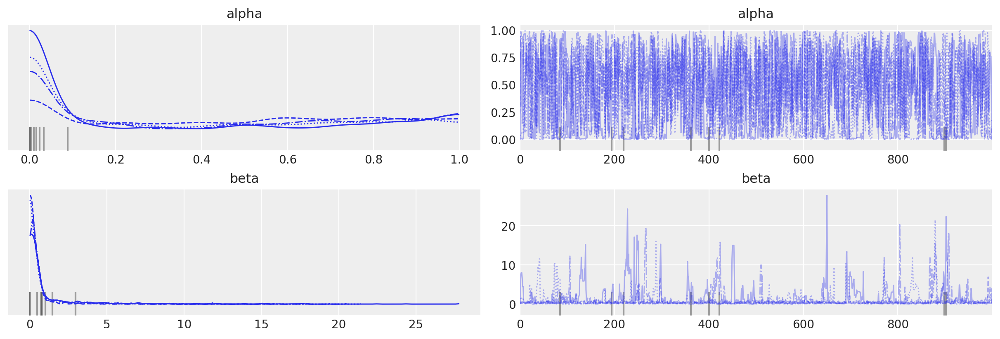

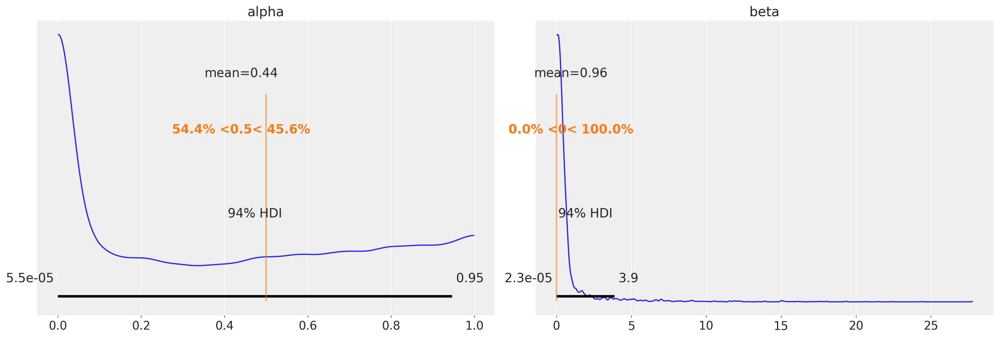

..........................................................................................
Experiment: [(1, 'training', None)]


Auto-assigning NUTS sampler...
INFO:pymc.sampling.mcmc:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc.sampling.mcmc:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
INFO:pymc.sampling.mcmc:Multiprocess sampling (4 chains in 4 jobs)
NUTS: [alpha, beta]
INFO:pymc.sampling.mcmc:NUTS: [alpha, beta]


Output()

Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 12 seconds.
INFO:pymc.sampling.mcmc:Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 12 seconds.
There were 12 divergences after tuning. Increase `target_accept` or reparameterize.
ERROR:pymc.stats.convergence:There were 12 divergences after tuning. Increase `target_accept` or reparameterize.


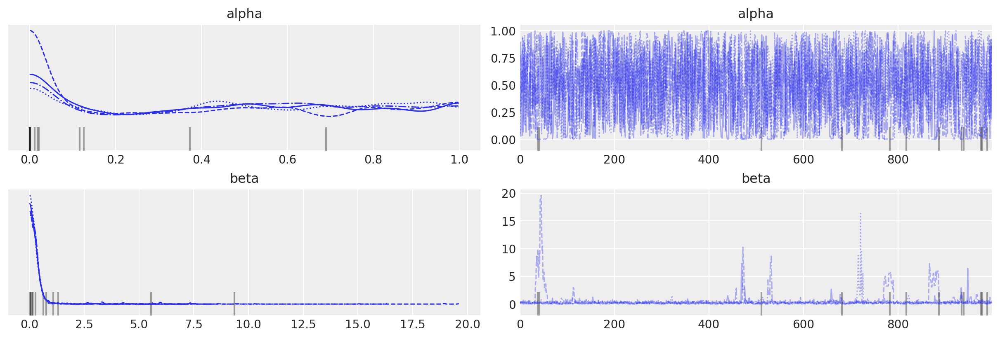

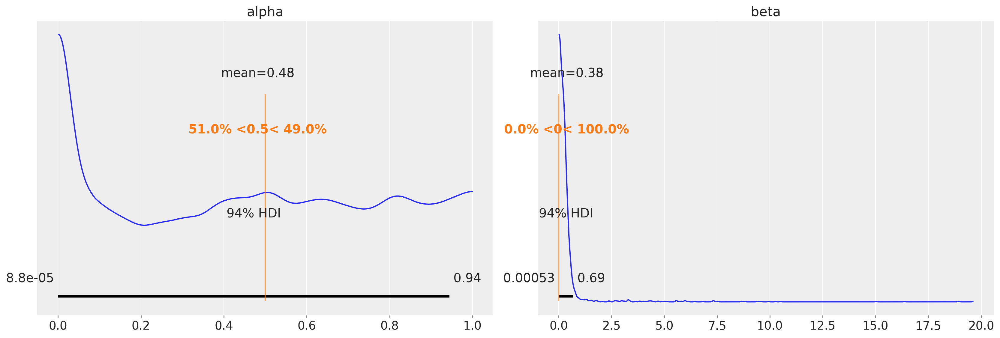

..........................................................................................
Experiment: [(2, 'ams1', None), (2, 'ams2', None)]


Auto-assigning NUTS sampler...
INFO:pymc.sampling.mcmc:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc.sampling.mcmc:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
INFO:pymc.sampling.mcmc:Multiprocess sampling (4 chains in 4 jobs)
NUTS: [alpha, beta]
INFO:pymc.sampling.mcmc:NUTS: [alpha, beta]


Output()

Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 24 seconds.
INFO:pymc.sampling.mcmc:Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 24 seconds.
There were 3 divergences after tuning. Increase `target_accept` or reparameterize.
ERROR:pymc.stats.convergence:There were 3 divergences after tuning. Increase `target_accept` or reparameterize.


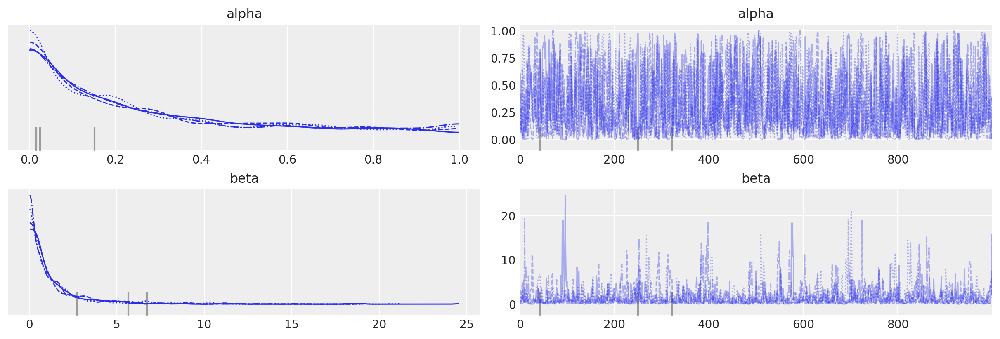

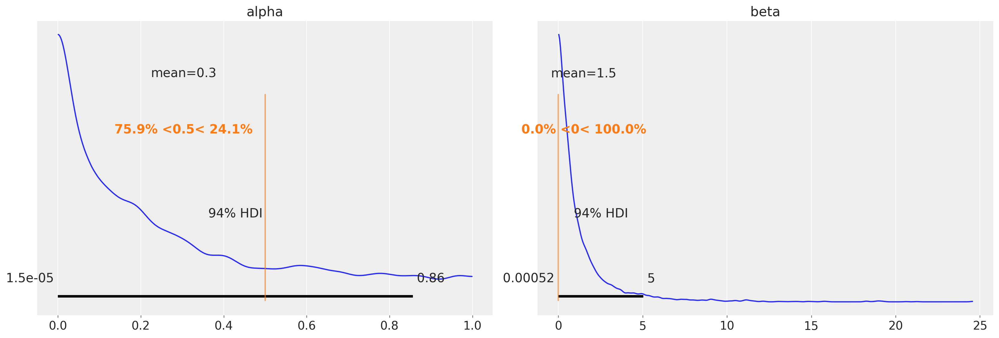

..........................................................................................
Experiment: [(2, 'eds1', None), (2, 'eds2', None)]


Auto-assigning NUTS sampler...
INFO:pymc.sampling.mcmc:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc.sampling.mcmc:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
INFO:pymc.sampling.mcmc:Multiprocess sampling (4 chains in 4 jobs)
NUTS: [alpha, beta]
INFO:pymc.sampling.mcmc:NUTS: [alpha, beta]


Output()

Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 15 seconds.
INFO:pymc.sampling.mcmc:Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 15 seconds.
There were 5 divergences after tuning. Increase `target_accept` or reparameterize.
ERROR:pymc.stats.convergence:There were 5 divergences after tuning. Increase `target_accept` or reparameterize.


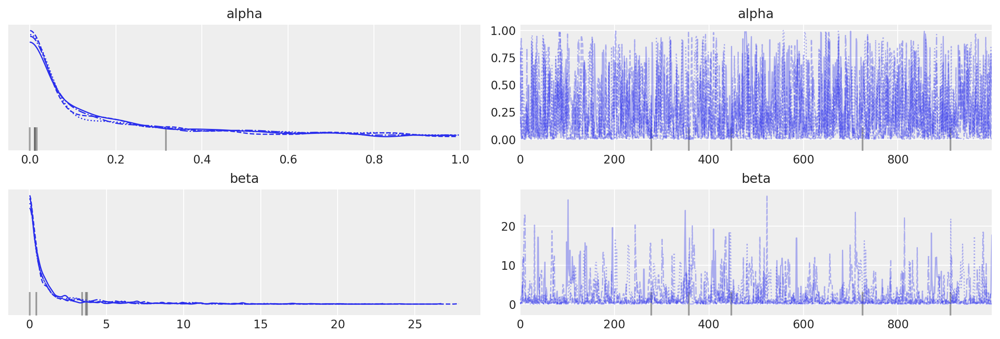

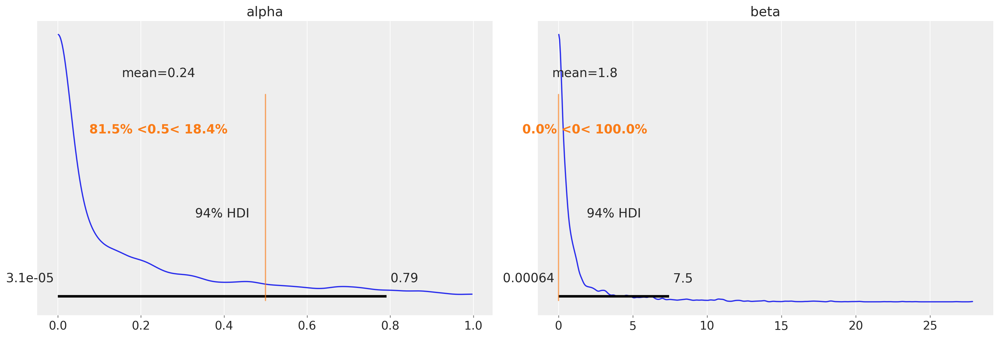

..........................................................................................
Experiment: [(2, 'ids1', None), (2, 'ids2', None)]


Auto-assigning NUTS sampler...
INFO:pymc.sampling.mcmc:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc.sampling.mcmc:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
INFO:pymc.sampling.mcmc:Multiprocess sampling (4 chains in 4 jobs)
NUTS: [alpha, beta]
INFO:pymc.sampling.mcmc:NUTS: [alpha, beta]


Output()

Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 13 seconds.
INFO:pymc.sampling.mcmc:Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 13 seconds.
There were 3 divergences after tuning. Increase `target_accept` or reparameterize.
ERROR:pymc.stats.convergence:There were 3 divergences after tuning. Increase `target_accept` or reparameterize.


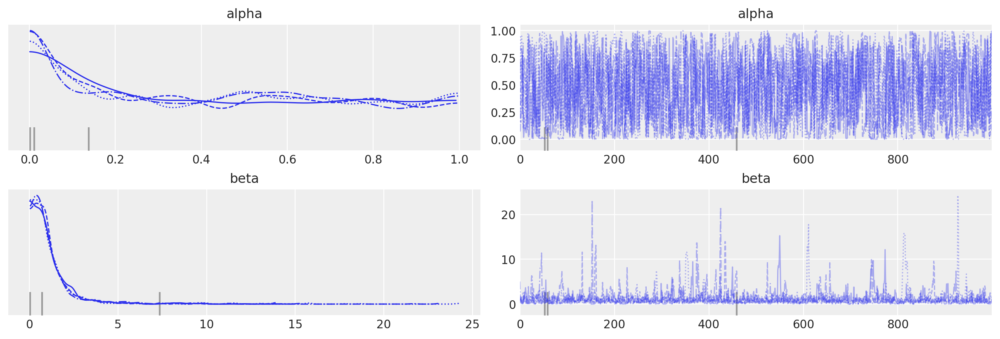

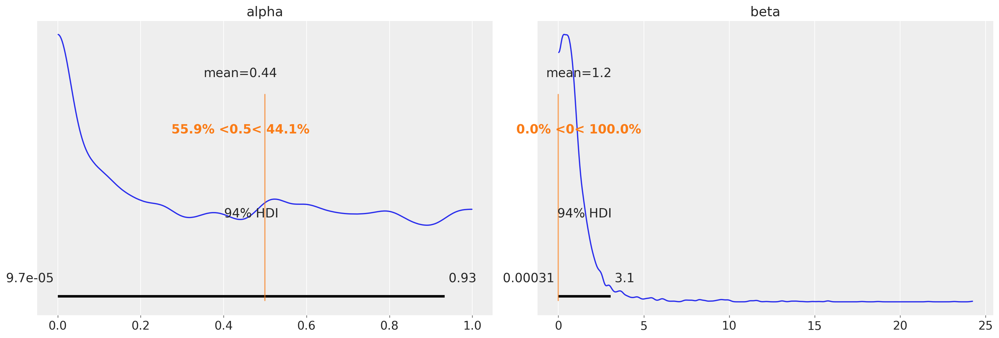

..........................................................................................
Experiment: [(2, 'staircase1', None), (2, 'staircase2', None)]


Auto-assigning NUTS sampler...
INFO:pymc.sampling.mcmc:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc.sampling.mcmc:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
INFO:pymc.sampling.mcmc:Multiprocess sampling (4 chains in 4 jobs)
NUTS: [alpha, beta]
INFO:pymc.sampling.mcmc:NUTS: [alpha, beta]


Output()

Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 19 seconds.
INFO:pymc.sampling.mcmc:Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 19 seconds.
There were 20 divergences after tuning. Increase `target_accept` or reparameterize.
ERROR:pymc.stats.convergence:There were 20 divergences after tuning. Increase `target_accept` or reparameterize.


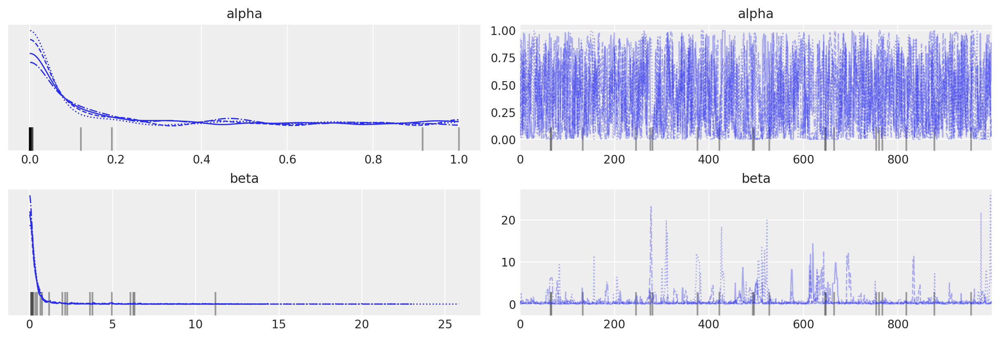

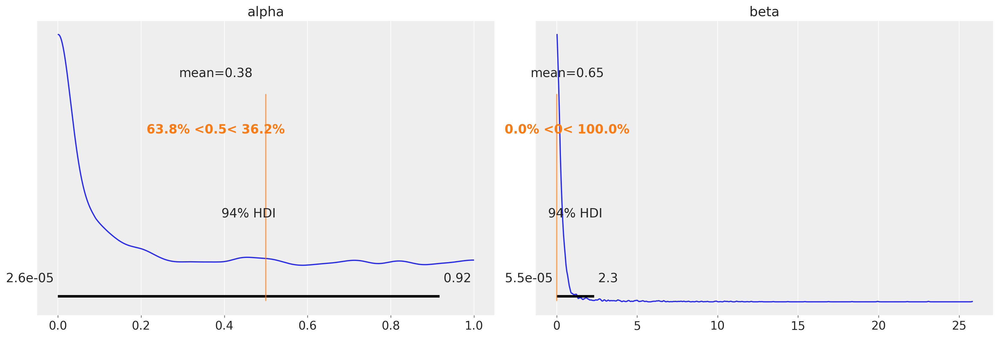

..........................................................................................
Experiment: [(2, 'training', None)]


Auto-assigning NUTS sampler...
INFO:pymc.sampling.mcmc:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc.sampling.mcmc:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
INFO:pymc.sampling.mcmc:Multiprocess sampling (4 chains in 4 jobs)
NUTS: [alpha, beta]
INFO:pymc.sampling.mcmc:NUTS: [alpha, beta]


Output()

Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 47 seconds.
INFO:pymc.sampling.mcmc:Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 47 seconds.
There were 8 divergences after tuning. Increase `target_accept` or reparameterize.
ERROR:pymc.stats.convergence:There were 8 divergences after tuning. Increase `target_accept` or reparameterize.


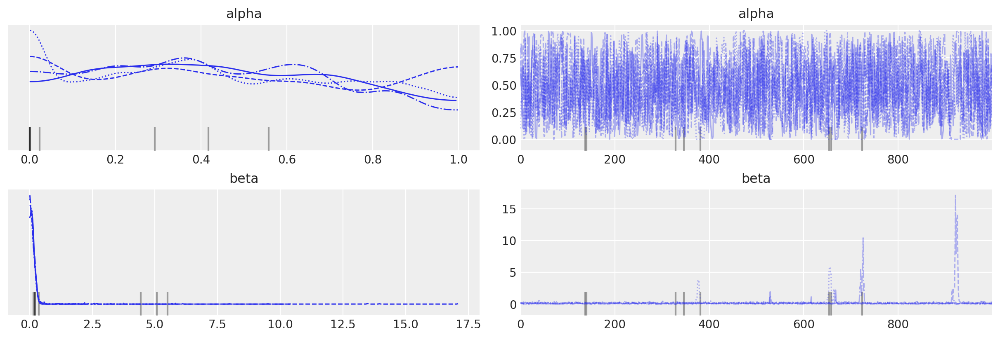

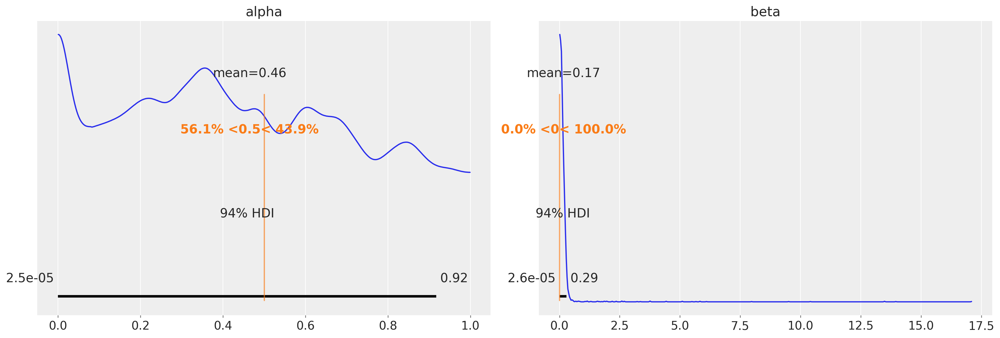

..........................................................................................
Experiment: [(3, 'ams1', None), (3, 'ams2', None)]


Auto-assigning NUTS sampler...
INFO:pymc.sampling.mcmc:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc.sampling.mcmc:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
INFO:pymc.sampling.mcmc:Multiprocess sampling (4 chains in 4 jobs)
NUTS: [alpha, beta]
INFO:pymc.sampling.mcmc:NUTS: [alpha, beta]


Output()

Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 22 seconds.
INFO:pymc.sampling.mcmc:Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 22 seconds.
There were 21 divergences after tuning. Increase `target_accept` or reparameterize.
ERROR:pymc.stats.convergence:There were 21 divergences after tuning. Increase `target_accept` or reparameterize.


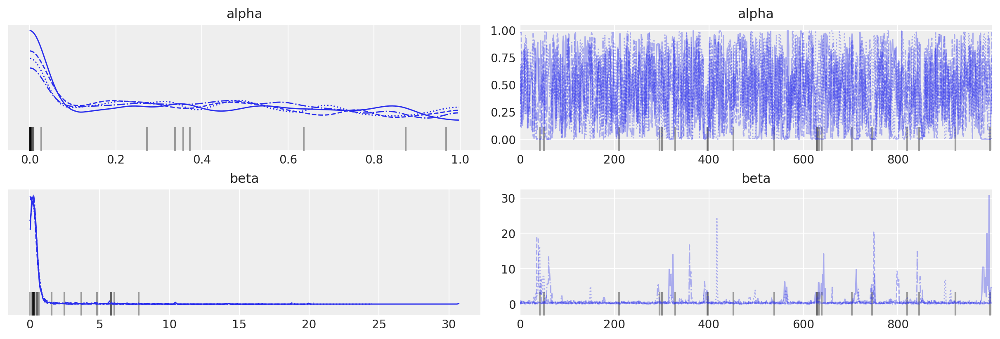

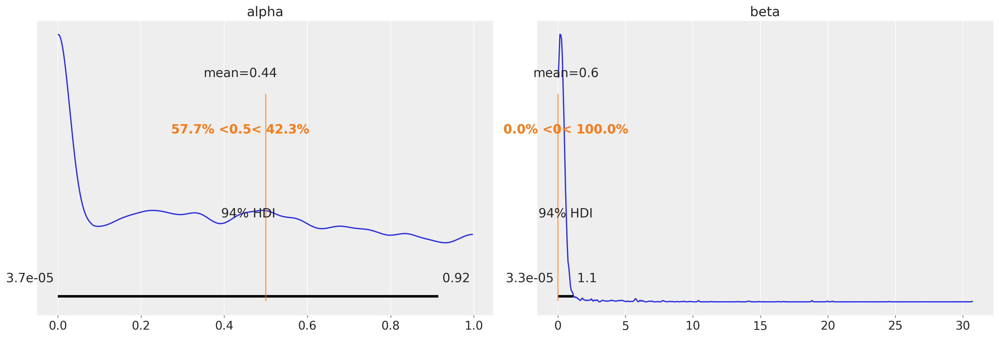

..........................................................................................
Experiment: [(3, 'eds1', None), (3, 'eds2', None)]


Auto-assigning NUTS sampler...
INFO:pymc.sampling.mcmc:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc.sampling.mcmc:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
INFO:pymc.sampling.mcmc:Multiprocess sampling (4 chains in 4 jobs)
NUTS: [alpha, beta]
INFO:pymc.sampling.mcmc:NUTS: [alpha, beta]


Output()

Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 13 seconds.
INFO:pymc.sampling.mcmc:Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 13 seconds.
There were 2 divergences after tuning. Increase `target_accept` or reparameterize.
ERROR:pymc.stats.convergence:There were 2 divergences after tuning. Increase `target_accept` or reparameterize.


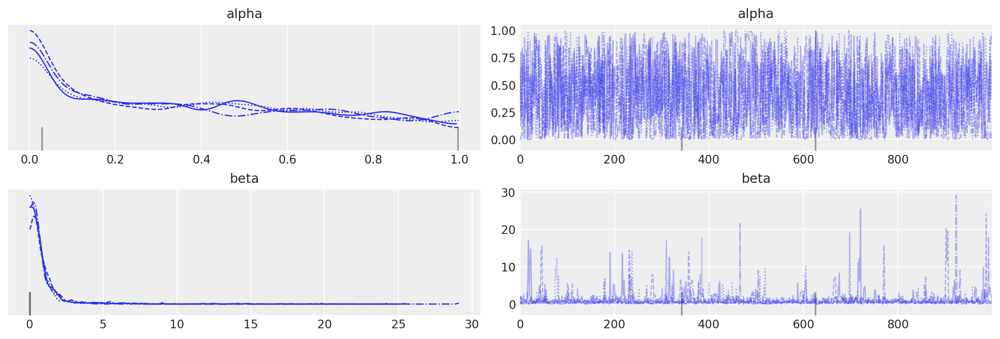

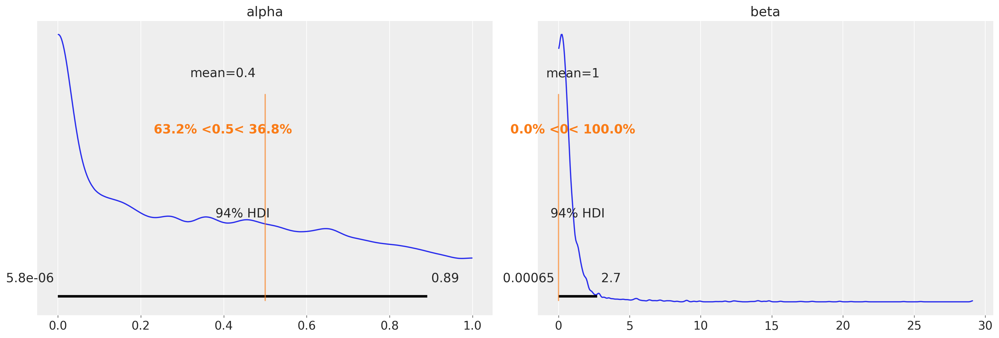

..........................................................................................
Experiment: [(3, 'ids1', None), (3, 'ids2', None)]


Auto-assigning NUTS sampler...
INFO:pymc.sampling.mcmc:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc.sampling.mcmc:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
INFO:pymc.sampling.mcmc:Multiprocess sampling (4 chains in 4 jobs)
NUTS: [alpha, beta]
INFO:pymc.sampling.mcmc:NUTS: [alpha, beta]


Output()

Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 18 seconds.
INFO:pymc.sampling.mcmc:Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 18 seconds.
There were 1 divergences after tuning. Increase `target_accept` or reparameterize.
ERROR:pymc.stats.convergence:There were 1 divergences after tuning. Increase `target_accept` or reparameterize.


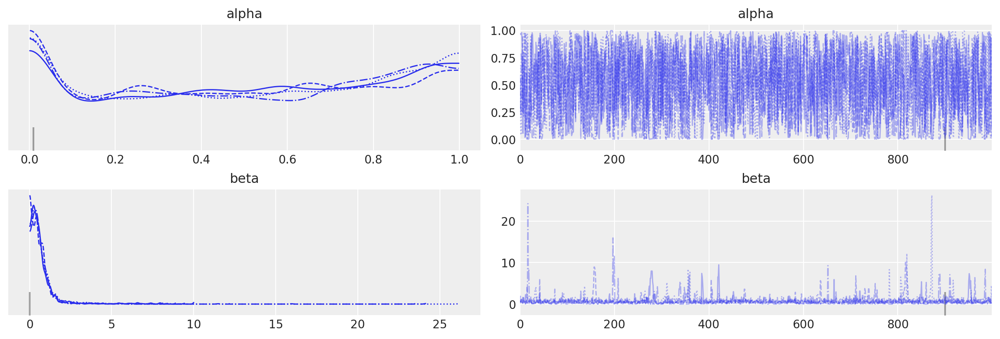

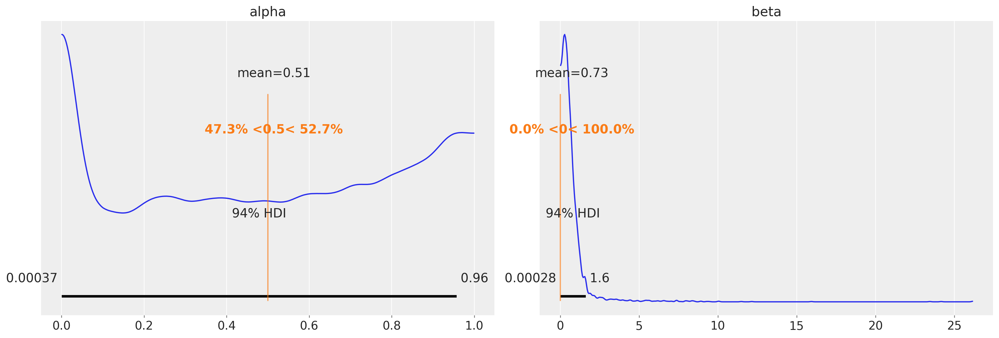

..........................................................................................
Experiment: [(3, 'staircase1', None), (3, 'staircase2', None)]


Auto-assigning NUTS sampler...
INFO:pymc.sampling.mcmc:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc.sampling.mcmc:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
INFO:pymc.sampling.mcmc:Multiprocess sampling (4 chains in 4 jobs)
NUTS: [alpha, beta]
INFO:pymc.sampling.mcmc:NUTS: [alpha, beta]


Output()

Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 24 seconds.
INFO:pymc.sampling.mcmc:Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 24 seconds.
There were 12 divergences after tuning. Increase `target_accept` or reparameterize.
ERROR:pymc.stats.convergence:There were 12 divergences after tuning. Increase `target_accept` or reparameterize.


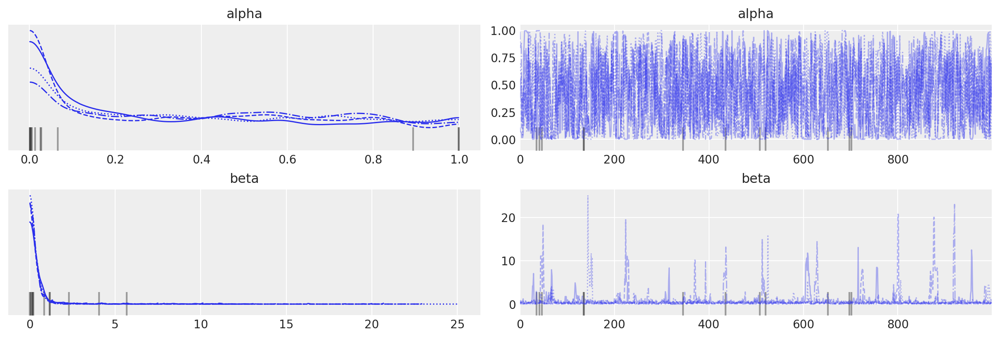

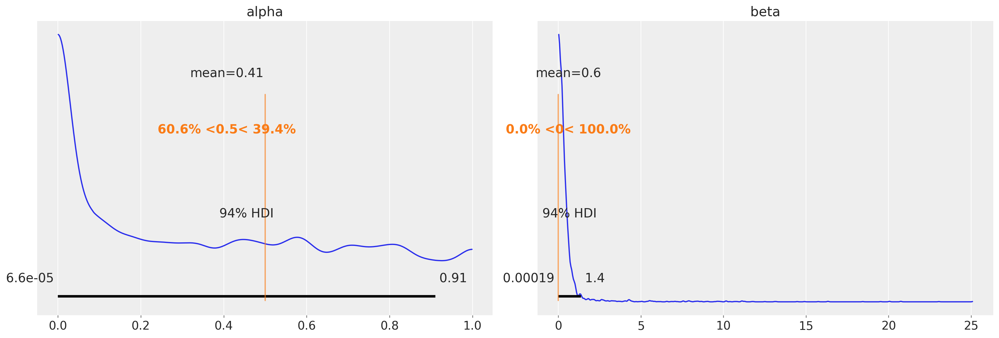

..........................................................................................
Experiment: [(3, 'training', None)]


Auto-assigning NUTS sampler...
INFO:pymc.sampling.mcmc:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc.sampling.mcmc:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
INFO:pymc.sampling.mcmc:Multiprocess sampling (4 chains in 4 jobs)
NUTS: [alpha, beta]
INFO:pymc.sampling.mcmc:NUTS: [alpha, beta]


Output()

Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 7 seconds.
INFO:pymc.sampling.mcmc:Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 7 seconds.
There were 5 divergences after tuning. Increase `target_accept` or reparameterize.
ERROR:pymc.stats.convergence:There were 5 divergences after tuning. Increase `target_accept` or reparameterize.


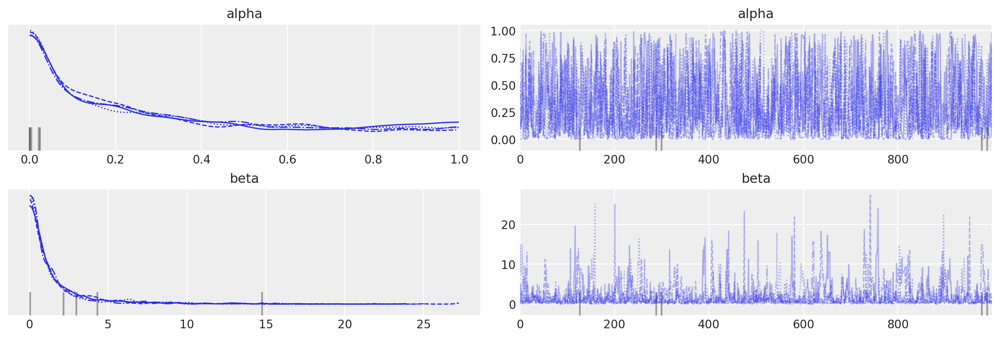

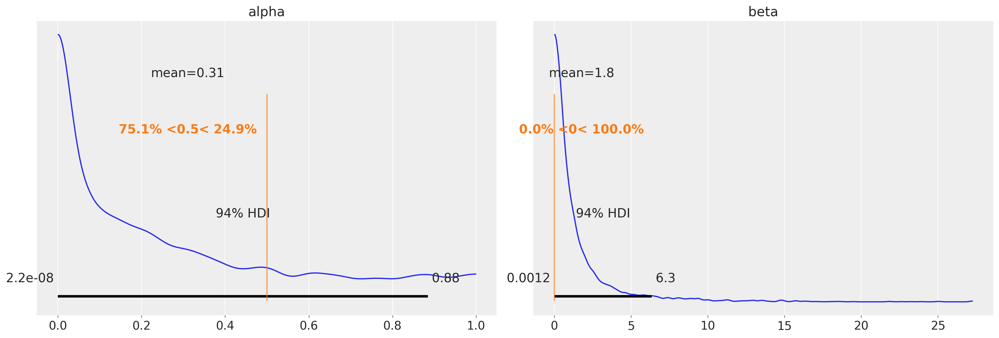

..........................................................................................
Experiment: [(4, 'ams1', None), (4, 'ams2', None)]


Auto-assigning NUTS sampler...
INFO:pymc.sampling.mcmc:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc.sampling.mcmc:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
INFO:pymc.sampling.mcmc:Multiprocess sampling (4 chains in 4 jobs)
NUTS: [alpha, beta]
INFO:pymc.sampling.mcmc:NUTS: [alpha, beta]


Output()

Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 23 seconds.
INFO:pymc.sampling.mcmc:Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 23 seconds.
There were 14 divergences after tuning. Increase `target_accept` or reparameterize.
ERROR:pymc.stats.convergence:There were 14 divergences after tuning. Increase `target_accept` or reparameterize.


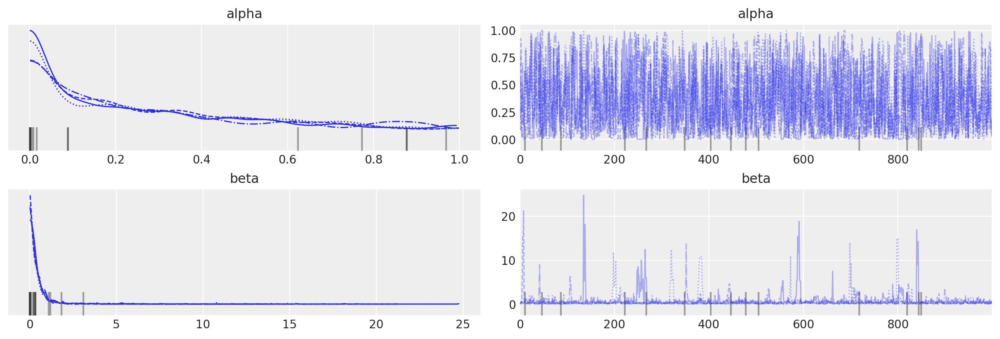

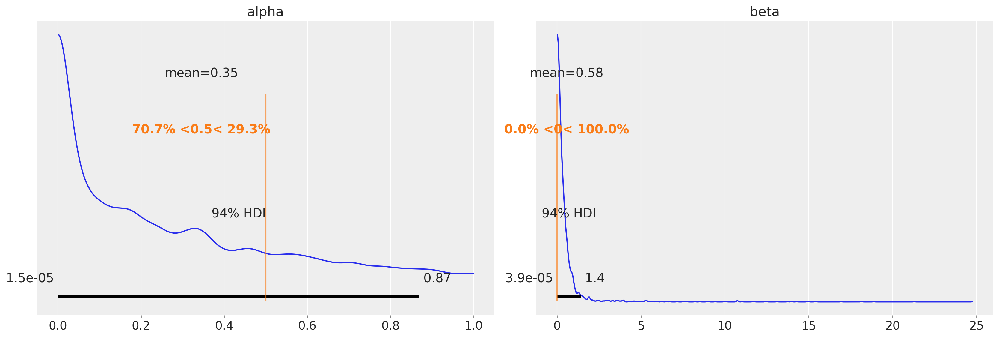

..........................................................................................
Experiment: [(4, 'eds1', None), (4, 'eds2', None)]


Auto-assigning NUTS sampler...
INFO:pymc.sampling.mcmc:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc.sampling.mcmc:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
INFO:pymc.sampling.mcmc:Multiprocess sampling (4 chains in 4 jobs)
NUTS: [alpha, beta]
INFO:pymc.sampling.mcmc:NUTS: [alpha, beta]


Output()

Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 12 seconds.
INFO:pymc.sampling.mcmc:Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 12 seconds.


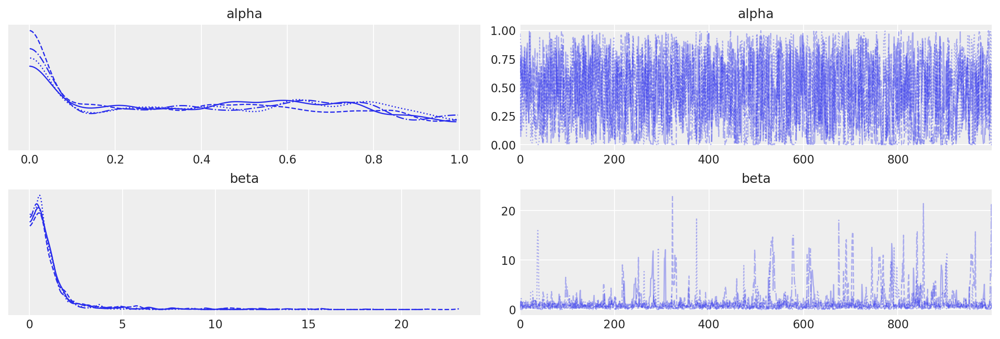

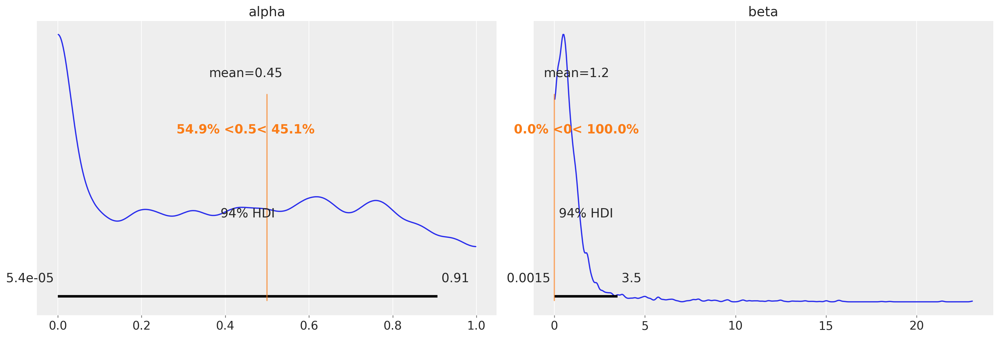

..........................................................................................
Experiment: [(4, 'ids1', None), (4, 'ids2', None)]


Auto-assigning NUTS sampler...
INFO:pymc.sampling.mcmc:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc.sampling.mcmc:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
INFO:pymc.sampling.mcmc:Multiprocess sampling (4 chains in 4 jobs)
NUTS: [alpha, beta]
INFO:pymc.sampling.mcmc:NUTS: [alpha, beta]


Output()

Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 11 seconds.
INFO:pymc.sampling.mcmc:Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 11 seconds.


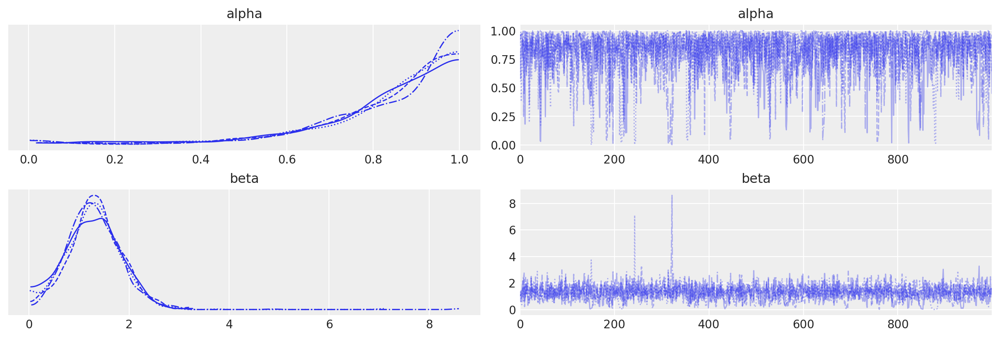

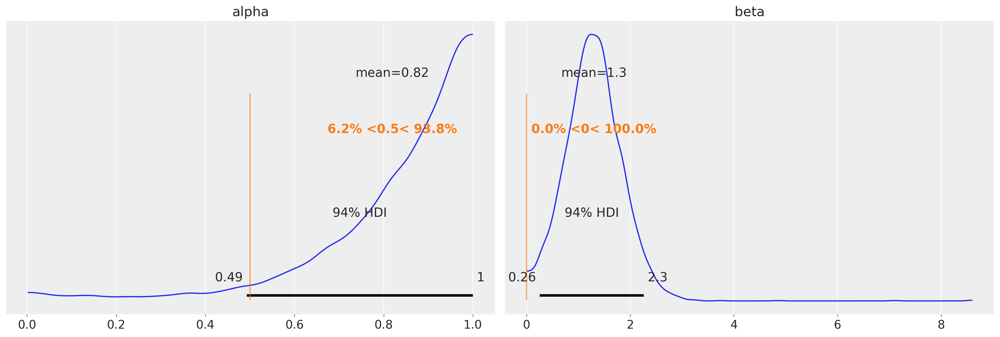

..........................................................................................
Experiment: [(4, 'staircase1', None), (4, 'staircase2', None)]


Auto-assigning NUTS sampler...
INFO:pymc.sampling.mcmc:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc.sampling.mcmc:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
INFO:pymc.sampling.mcmc:Multiprocess sampling (4 chains in 4 jobs)
NUTS: [alpha, beta]
INFO:pymc.sampling.mcmc:NUTS: [alpha, beta]


Output()

Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 33 seconds.
INFO:pymc.sampling.mcmc:Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 33 seconds.


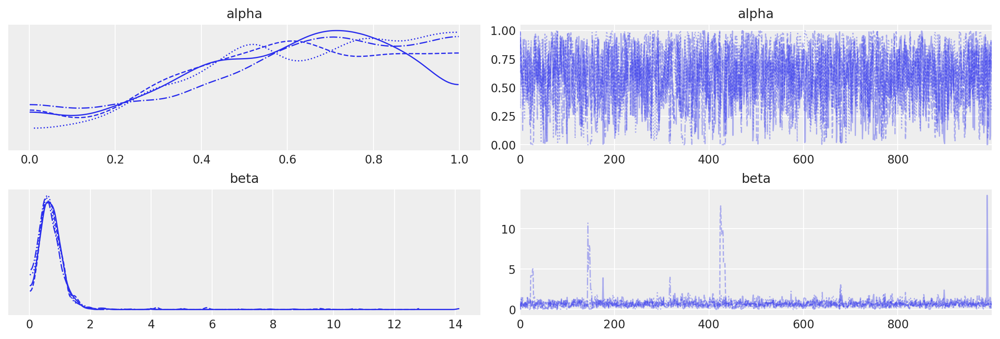

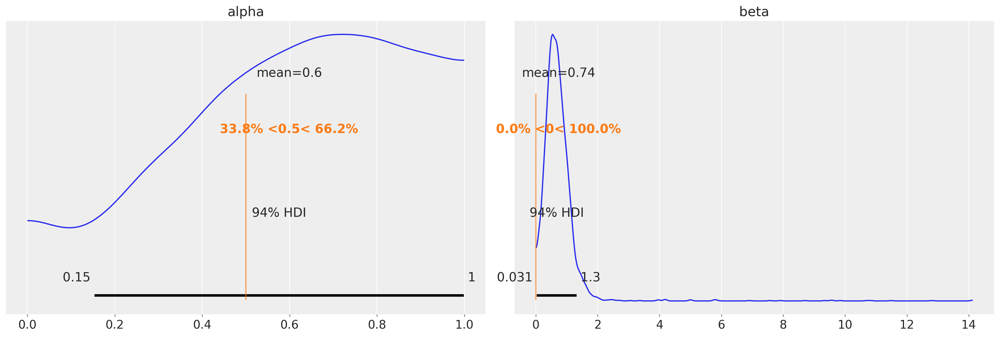

..........................................................................................
Experiment: [(4, 'training', None)]


Auto-assigning NUTS sampler...
INFO:pymc.sampling.mcmc:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc.sampling.mcmc:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
INFO:pymc.sampling.mcmc:Multiprocess sampling (4 chains in 4 jobs)
NUTS: [alpha, beta]
INFO:pymc.sampling.mcmc:NUTS: [alpha, beta]


Output()

Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 13 seconds.
INFO:pymc.sampling.mcmc:Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 13 seconds.
There were 38 divergences after tuning. Increase `target_accept` or reparameterize.
ERROR:pymc.stats.convergence:There were 38 divergences after tuning. Increase `target_accept` or reparameterize.


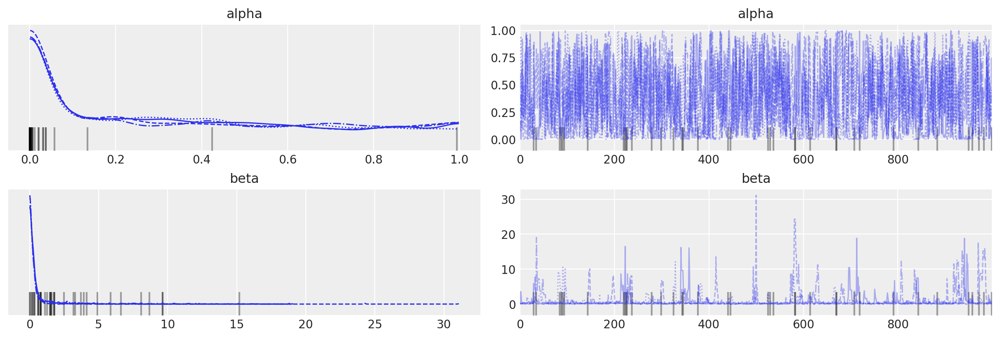

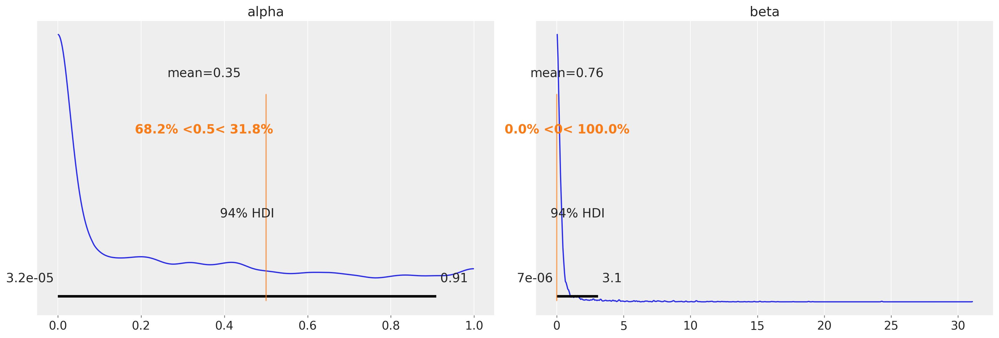

..........................................................................................
Experiment: [(5, 'ams1', None), (5, 'ams2', None)]


Auto-assigning NUTS sampler...
INFO:pymc.sampling.mcmc:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc.sampling.mcmc:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
INFO:pymc.sampling.mcmc:Multiprocess sampling (4 chains in 4 jobs)
NUTS: [alpha, beta]
INFO:pymc.sampling.mcmc:NUTS: [alpha, beta]


Output()

Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 469 seconds.
INFO:pymc.sampling.mcmc:Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 469 seconds.
There were 52 divergences after tuning. Increase `target_accept` or reparameterize.
ERROR:pymc.stats.convergence:There were 52 divergences after tuning. Increase `target_accept` or reparameterize.


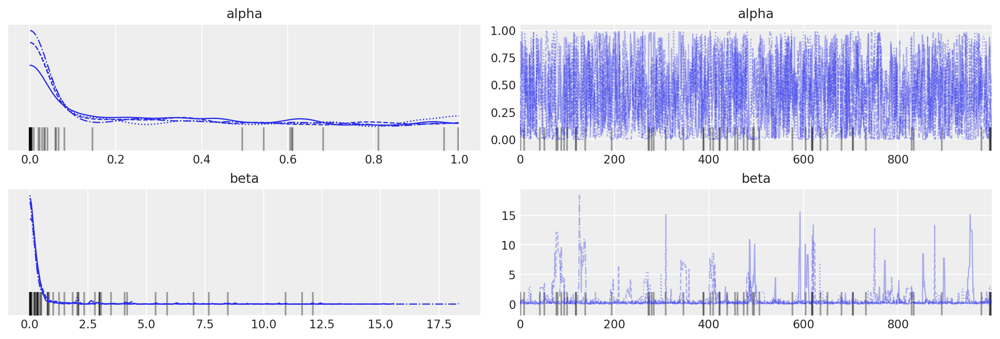

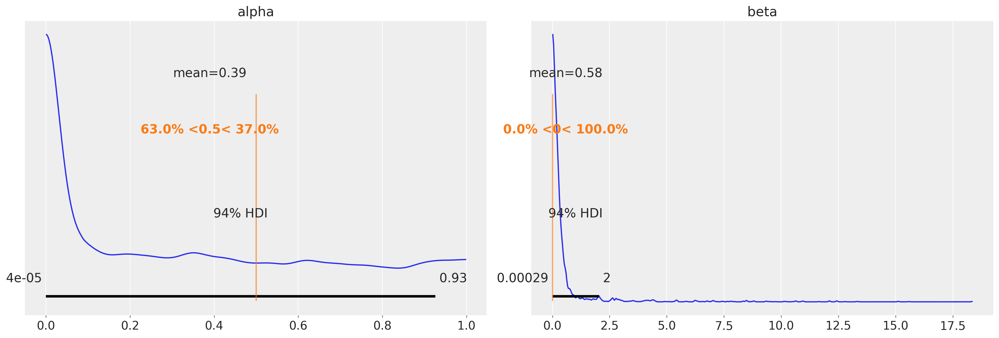

..........................................................................................
Experiment: [(5, 'eds1', None), (5, 'eds2', None)]


Auto-assigning NUTS sampler...
INFO:pymc.sampling.mcmc:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc.sampling.mcmc:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
INFO:pymc.sampling.mcmc:Multiprocess sampling (4 chains in 4 jobs)
NUTS: [alpha, beta]
INFO:pymc.sampling.mcmc:NUTS: [alpha, beta]


Output()

Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 15 seconds.
INFO:pymc.sampling.mcmc:Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 15 seconds.
There were 2 divergences after tuning. Increase `target_accept` or reparameterize.
ERROR:pymc.stats.convergence:There were 2 divergences after tuning. Increase `target_accept` or reparameterize.


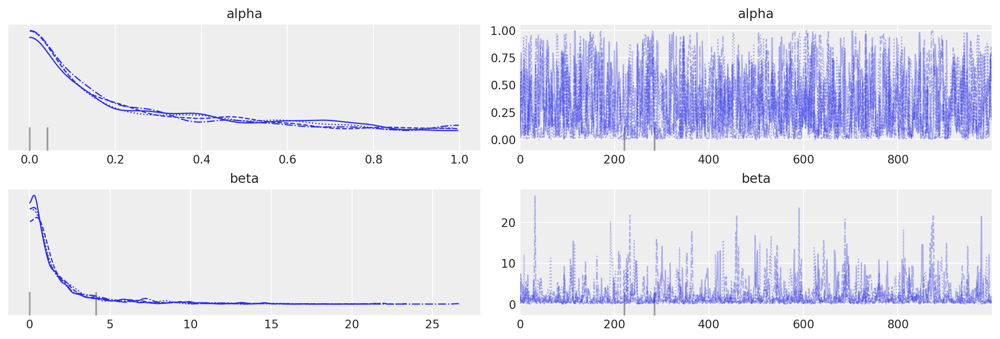

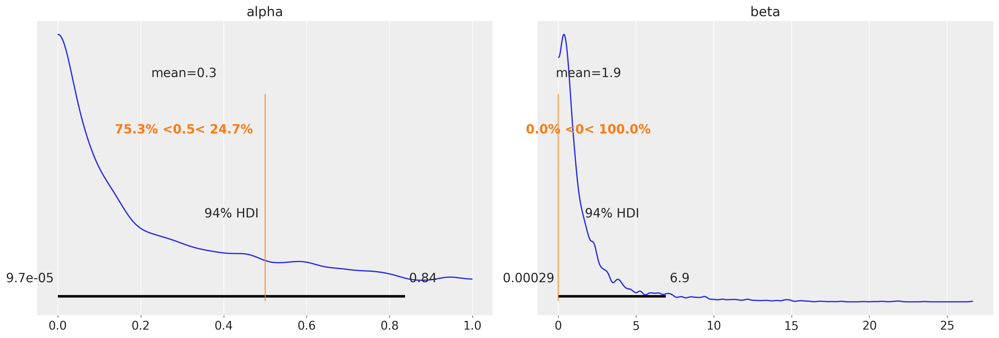

..........................................................................................
Experiment: [(5, 'ids1', None), (5, 'ids2', None)]


Auto-assigning NUTS sampler...
INFO:pymc.sampling.mcmc:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc.sampling.mcmc:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
INFO:pymc.sampling.mcmc:Multiprocess sampling (4 chains in 4 jobs)
NUTS: [alpha, beta]
INFO:pymc.sampling.mcmc:NUTS: [alpha, beta]


Output()

Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 683 seconds.
INFO:pymc.sampling.mcmc:Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 683 seconds.
There were 8 divergences after tuning. Increase `target_accept` or reparameterize.
ERROR:pymc.stats.convergence:There were 8 divergences after tuning. Increase `target_accept` or reparameterize.


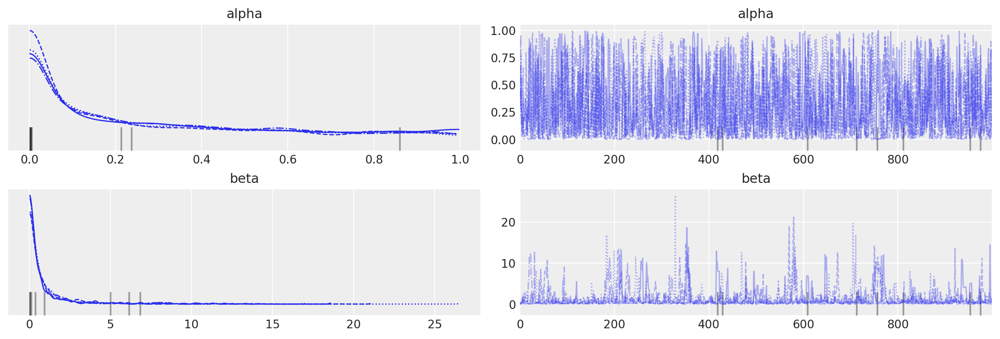

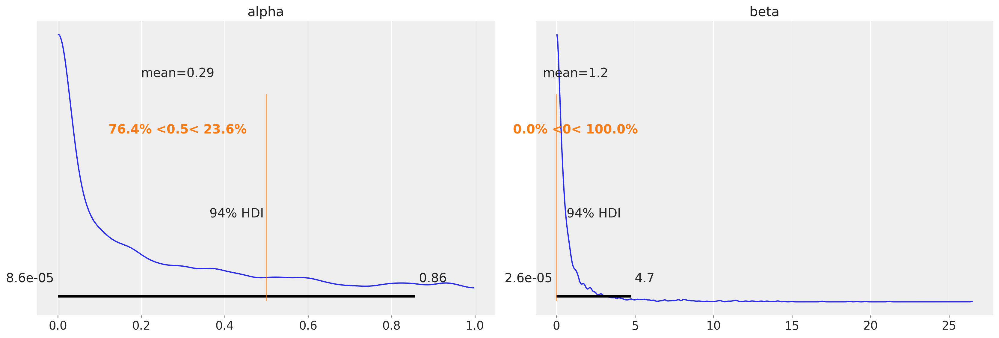

..........................................................................................
Experiment: [(5, 'staircase1', None), (5, 'staircase2', None)]


Auto-assigning NUTS sampler...
INFO:pymc.sampling.mcmc:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc.sampling.mcmc:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
INFO:pymc.sampling.mcmc:Multiprocess sampling (4 chains in 4 jobs)
NUTS: [alpha, beta]
INFO:pymc.sampling.mcmc:NUTS: [alpha, beta]


Output()

Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 24 seconds.
INFO:pymc.sampling.mcmc:Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 24 seconds.
There were 2 divergences after tuning. Increase `target_accept` or reparameterize.
ERROR:pymc.stats.convergence:There were 2 divergences after tuning. Increase `target_accept` or reparameterize.


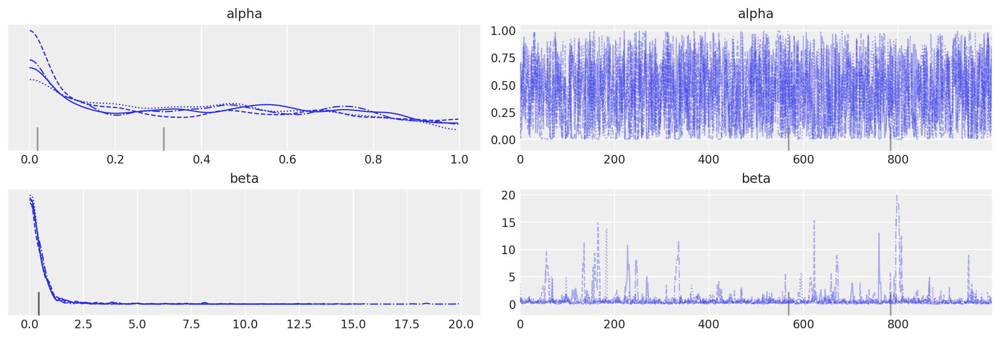

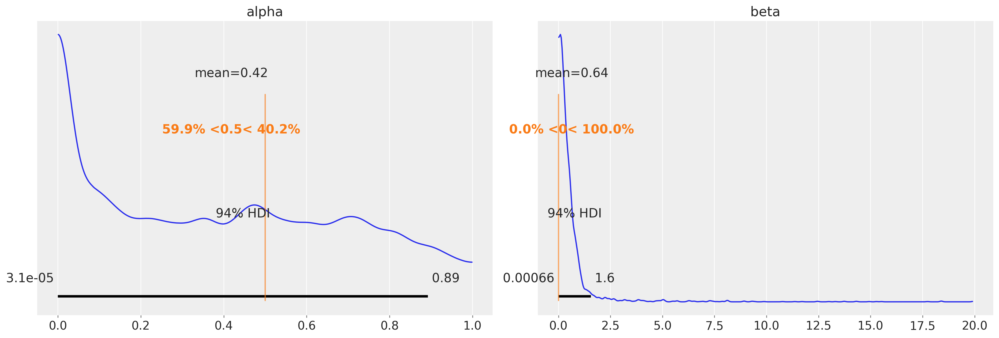

..........................................................................................
Experiment: [(5, 'training', None)]


Auto-assigning NUTS sampler...
INFO:pymc.sampling.mcmc:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc.sampling.mcmc:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
INFO:pymc.sampling.mcmc:Multiprocess sampling (4 chains in 4 jobs)
NUTS: [alpha, beta]
INFO:pymc.sampling.mcmc:NUTS: [alpha, beta]


Output()

Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 12 seconds.
INFO:pymc.sampling.mcmc:Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 12 seconds.
There were 8 divergences after tuning. Increase `target_accept` or reparameterize.
ERROR:pymc.stats.convergence:There were 8 divergences after tuning. Increase `target_accept` or reparameterize.


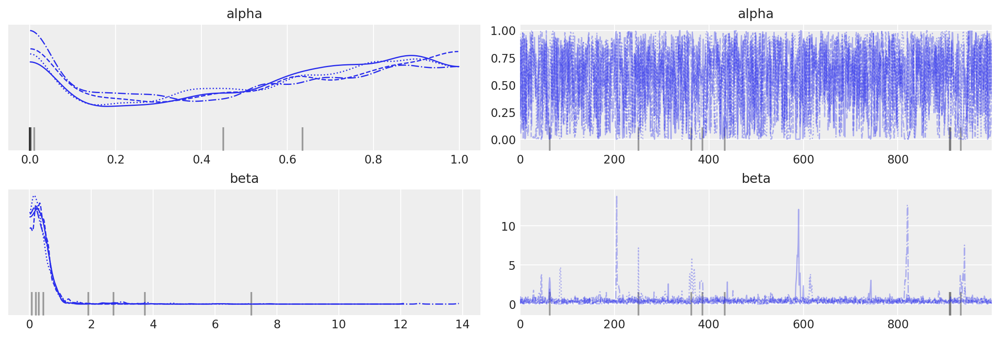

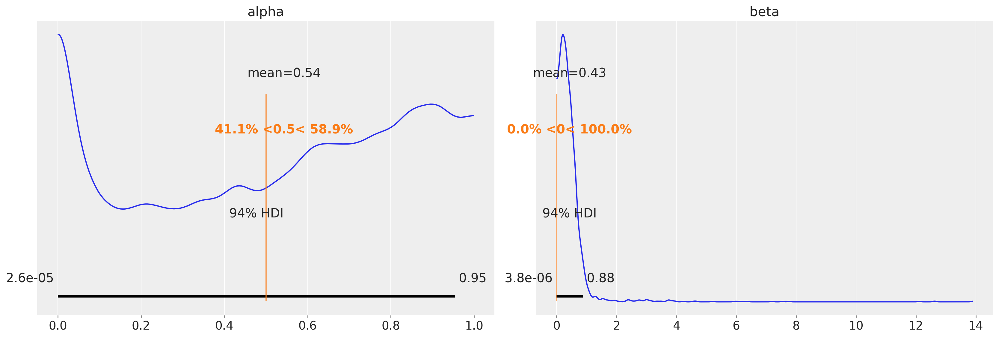

..........................................................................................
Experiment: [(6, 'ams1', None), (6, 'ams2', None)]


Auto-assigning NUTS sampler...
INFO:pymc.sampling.mcmc:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc.sampling.mcmc:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
INFO:pymc.sampling.mcmc:Multiprocess sampling (4 chains in 4 jobs)
NUTS: [alpha, beta]
INFO:pymc.sampling.mcmc:NUTS: [alpha, beta]


Output()

Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 23 seconds.
INFO:pymc.sampling.mcmc:Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 23 seconds.
There were 3 divergences after tuning. Increase `target_accept` or reparameterize.
ERROR:pymc.stats.convergence:There were 3 divergences after tuning. Increase `target_accept` or reparameterize.


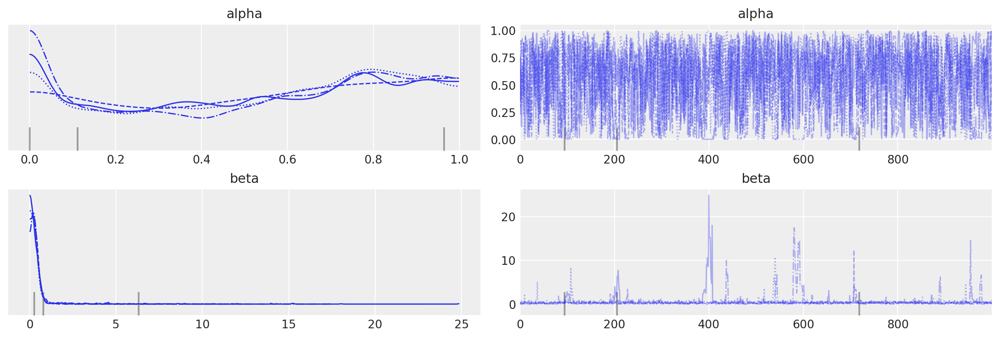

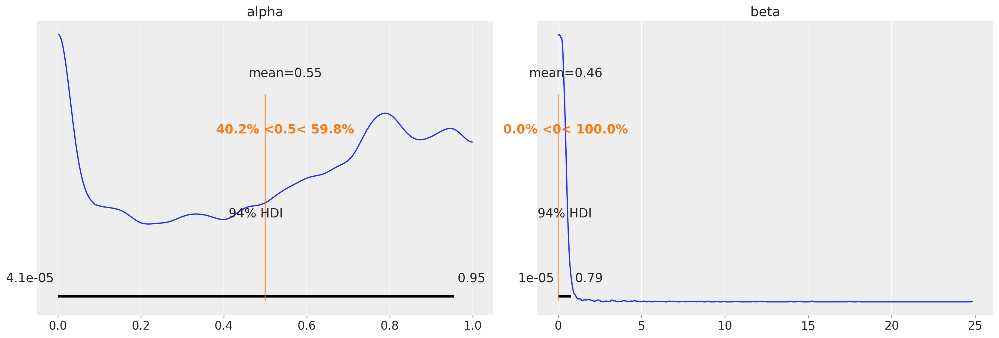

..........................................................................................
Experiment: [(6, 'eds1', None), (6, 'eds2', None)]


Auto-assigning NUTS sampler...
INFO:pymc.sampling.mcmc:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc.sampling.mcmc:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
INFO:pymc.sampling.mcmc:Multiprocess sampling (4 chains in 4 jobs)
NUTS: [alpha, beta]
INFO:pymc.sampling.mcmc:NUTS: [alpha, beta]


Output()

Sampling 4 chains for 1_000 tune and 417 draw iterations (4_000 + 1_668 draws total) took 9 seconds.
INFO:pymc.sampling.mcmc:Sampling 4 chains for 1_000 tune and 417 draw iterations (4_000 + 1_668 draws total) took 9 seconds.
There were 4 divergences after tuning. Increase `target_accept` or reparameterize.
ERROR:pymc.stats.convergence:There were 4 divergences after tuning. Increase `target_accept` or reparameterize.
The rhat statistic is larger than 1.01 for some parameters. This indicates problems during sampling. See https://arxiv.org/abs/1903.08008 for details
INFO:pymc.stats.convergence:The rhat statistic is larger than 1.01 for some parameters. This indicates problems during sampling. See https://arxiv.org/abs/1903.08008 for details
The effective sample size per chain is smaller than 100 for some parameters.  A higher number is needed for reliable rhat and ess computation. See https://arxiv.org/abs/1903.08008 for details
ERROR:pymc.stats.convergence:The effective sample size per 

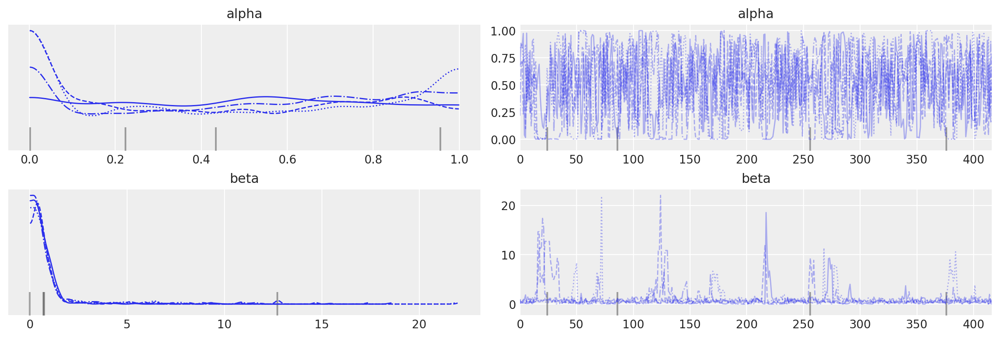

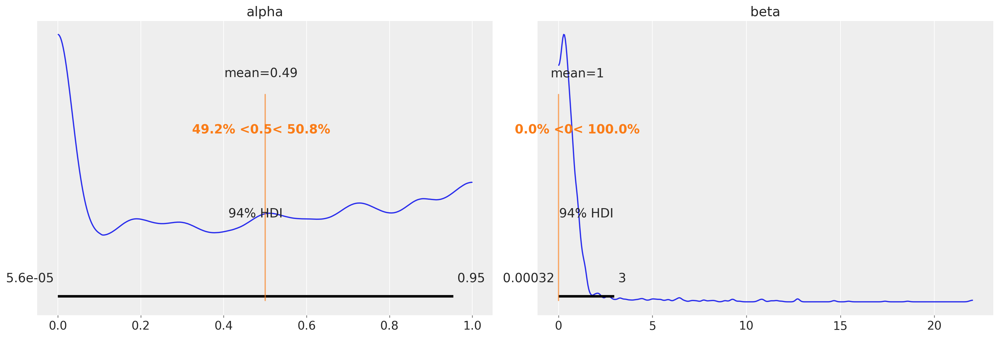

..........................................................................................
Experiment: [(6, 'ids1', None), (6, 'ids2', None)]


Auto-assigning NUTS sampler...
INFO:pymc.sampling.mcmc:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc.sampling.mcmc:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
INFO:pymc.sampling.mcmc:Multiprocess sampling (4 chains in 4 jobs)
NUTS: [alpha, beta]
INFO:pymc.sampling.mcmc:NUTS: [alpha, beta]


Output()

In [68]:
for experiment in experiments:
    print('...'*30)
    print(f'Experiment: {experiment}')
    qsd = QuerySequenceData(StimCode, RespCode)
    for _key in experiment:
        qsd.filter_sequences(*_key, update_existing_stim_resp=True)
    qsd.extract_stim_resp_data()
    qsd.infer_action_reward_pairs()
    ACTIONS = qsd._action
    REWARDS = qsd._reward
    m_alt, like, tr_alt = fit_Bernoulli(ACTIONS, REWARDS)
    az.plot_trace(data=tr_alt);
    az.plot_posterior(data=tr_alt, ref_val=[0.5, 0]);
    plt.show()
    
    